In [1]:
# 라이브러리 실행
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
import os
plt.style.use('ggplot')
import folium
import seaborn as sns

try:
    os.chdir("D:\Portfolio\Project\빅데이터 윈터스쿨\[project]daycon-제주버스정류장 승하차 예측")
    print("Current Working Directory is changed.")
except OSError:
    print("Can't change Current Working Directory.") 

Current Working Directory is changed.


In [2]:
# 데이터 불러오기
data=pd.read_csv("train.csv",encoding="utf8")
data.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,9~10_ride,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,5.0,2.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,2.0,5.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,26.0,14.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [3]:
# 데이터 정보 확인
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 415423 entries, 0 to 415422
Data columns (total 21 columns):
id               415423 non-null int64
date             415423 non-null object
bus_route_id     415423 non-null int64
in_out           415423 non-null object
station_code     415423 non-null int64
station_name     415423 non-null object
latitude         415423 non-null float64
longitude        415423 non-null float64
6~7_ride         415423 non-null float64
7~8_ride         415423 non-null float64
8~9_ride         415423 non-null float64
9~10_ride        415423 non-null float64
10~11_ride       415423 non-null float64
11~12_ride       415423 non-null float64
6~7_takeoff      415423 non-null float64
7~8_takeoff      415423 non-null float64
8~9_takeoff      415423 non-null float64
9~10_takeoff     415423 non-null float64
10~11_takeoff    415423 non-null float64
11~12_takeoff    415423 non-null float64
18~20_ride       415423 non-null float64
dtypes: float64(15), int64(3), object

In [4]:
# 행과 열 확인
data.shape 

(415423, 21)

In [5]:
# 변수 요약 통계량 확인
data.describe()

,id,bus_route_id,station_code,latitude,longitude,6~7_ride,7~8_ride,8~9_ride,9~10_ride,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride
count,415423.000000,4.154230e+05,4.154230e+05,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000,415423.000000
mean,207711.000000,2.691935e+07,4.209311e+04,33.420375,126.533574,0.305893,0.829699,0.815350,0.642475,0.599618,0.579393,0.112870,0.344870,0.516481,0.430922,0.408001,0.402874,1.242095
std,119922.434776,3.924652e+06,4.971504e+05,0.107996,0.140986,1.109766,2.255116,2.317561,1.959844,1.885941,1.942137,0.597714,1.279179,1.658850,1.485124,1.412839,1.446080,4.722287
min,0.000000,4.270000e+06,1.000000e+00,33.208350,126.165040,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,103855.500000,2.346000e+07,3.200000e+02,33.291080,126.475780,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,207711.000000,2.803000e+07,1.130000e+03,33.478850,126.529770,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,311566.500000,3.003000e+07,2.226000e+03,33.500020,126.575890,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,415422.000000,3.282000e+07,6.115101e+06,33.963640,126.965670,85.000000,94.000000,136.000000,78.000000,124.000000,99.000000,45.000000,66.000000,59.000000,65.000000,52.000000,81.000000,272.000000


In [6]:
#데이터 변수 변환

data['date']=pd.to_datetime(data['date'])

In [7]:
# 요일 만들기

data['weekday'] = data['date'].dt.weekday
data.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,weekday
0,0,2019-09-01,4270000,시외,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,2.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6
1,1,2019-09-01,4270000,시외,357,한라병원,33.48944,126.48508,1.0,4.0,...,5.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,6
2,2,2019-09-01,4270000,시외,432,정존마을,33.48181,126.47352,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,6
3,3,2019-09-01,4270000,시내,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,14.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0,6
4,4,2019-09-01,4270000,시내,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,6


In [8]:
# 시내와 시외로 나누어져 있는 in_out 변수를 변환해주자!

data['in_out'].value_counts() # value_counts() 함수는 변수값의 빈도를 세어준다!

# 시내에 비해 시외가 적음
#  map 함수를 이용해 binary 변수화 시키자

시내    408500
시외      6923
Name: in_out, dtype: int64

In [9]:
# 시내, 시외 데이터 변환
data['in_out'] =data['in_out'].map({'시내':0,'시외':1})

In [10]:
data.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,10~11_ride,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,weekday
0,0,2019-09-01,4270000,1,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,2.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6
1,1,2019-09-01,4270000,1,357,한라병원,33.48944,126.48508,1.0,4.0,...,5.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,6
2,2,2019-09-01,4270000,1,432,정존마을,33.48181,126.47352,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,6
3,3,2019-09-01,4270000,0,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,14.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0,6
4,4,2019-09-01,4270000,0,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,6


In [11]:
# 탑승 데이터 합치기
data["ride"]=data["6~7_ride"]+data["7~8_ride"]+data["8~9_ride"]+data["9~10_ride"]+data["10~11_ride"]+data["11~12_ride"]+data["18~20_ride"]
data.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,11~12_ride,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,weekday,ride
0,0,2019-09-01,4270000,1,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6,16.0
1,1,2019-09-01,4270000,1,357,한라병원,33.48944,126.48508,1.0,4.0,...,6.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,6,27.0
2,2,2019-09-01,4270000,1,432,정존마을,33.48181,126.47352,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,6,6.0
3,3,2019-09-01,4270000,0,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,16.0,0.0,0.0,0.0,0.0,0.0,0.0,53.0,6,132.0
4,4,2019-09-01,4270000,0,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,6,0.0


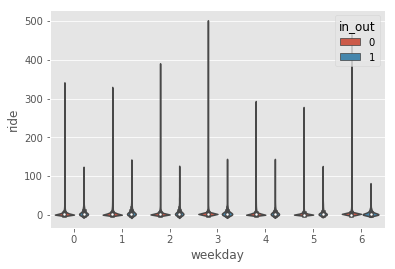

In [12]:
# 요일별 시내,외 버스 이용 현황

sns.violinplot(x="weekday", y="ride", hue="in_out", data=data) #hue 파라미터 추가

In [13]:
# take 로 하차 데이터 묶기
data["takeoff"]=data["6~7_takeoff"]+data["7~8_takeoff"]+data["8~9_takeoff"]+data["9~10_takeoff"]+data["10~11_takeoff"]+data["11~12_takeoff"]
data.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,6~7_takeoff,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,weekday,ride,takeoff
0,0,2019-09-01,4270000,1,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6,16.0,0.0
1,1,2019-09-01,4270000,1,357,한라병원,33.48944,126.48508,1.0,4.0,...,0.0,0.0,0.0,0.0,0.0,0.0,5.0,6,27.0,0.0
2,2,2019-09-01,4270000,1,432,정존마을,33.48181,126.47352,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2.0,6,6.0,0.0
3,3,2019-09-01,4270000,0,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,0.0,0.0,0.0,0.0,0.0,0.0,53.0,6,132.0,0.0
4,4,2019-09-01,4270000,0,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,6,0.0,1.0


In [14]:
# 총 탑승객 묶기
data["passenger"]=data["ride"]+data['takeoff']
data.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,7~8_takeoff,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,weekday,ride,takeoff,passenger
0,0,2019-09-01,4270000,1,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,6,16.0,0.0,16.0
1,1,2019-09-01,4270000,1,357,한라병원,33.48944,126.48508,1.0,4.0,...,0.0,0.0,0.0,0.0,0.0,5.0,6,27.0,0.0,27.0
2,2,2019-09-01,4270000,1,432,정존마을,33.48181,126.47352,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,2.0,6,6.0,0.0,6.0
3,3,2019-09-01,4270000,0,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,0.0,0.0,0.0,0.0,0.0,53.0,6,132.0,0.0,132.0
4,4,2019-09-01,4270000,0,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,6,0.0,1.0,1.0


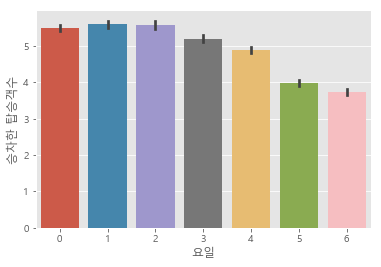

In [15]:
# 요일별 버스를 타는 사람 총합

plt.rc('font', family='Malgun Gothic')
sns.barplot(x="weekday",y="ride",data=data)
plt.xlabel('요일')
plt.ylabel('승차한 탑승객수')
plt.show()

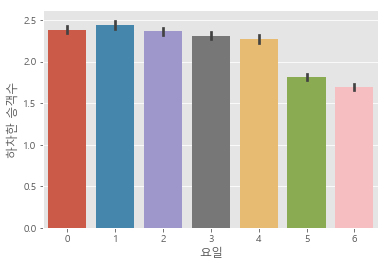

In [16]:
plt.rc('font', family='Malgun Gothic')
sns.barplot(x="weekday",y="takeoff",data=data)
plt.xlabel('요일')
plt.ylabel('하차한 승객수')
plt.show()

In [17]:
# 시간별 가장 많이 이용하는 버스
data['station_code']

0             344
1             357
2             432
3            1579
4            1646
5            1648
6            1660
7            1666
8            1726
9            2008
10           2009
11           2013
12           2014
13           2094
14           2095
15           2114
16           2494
17           2697
18           2699
19           2843
20           2851
21           2885
22           2966
23           3031
24           4154
25            343
26            358
27            431
28           1636
29           1645
           ...   
415393        122
415394        129
415395        136
415396        147
415397        164
415398       1261
415399       1629
415400       2522
415401       2645
415402       2650
415403       2651
415404       2969
415405       3271
415406       3273
415407       3275
415408       3279
415409       3281
415410       3289
415411       1129
415412       2468
415413    6115100
415414         96
415415        737
415416        786
415417    

In [18]:
addr = data[['station_code','latitude','longitude']] # 정류장 코드, 위도, 경도 뽑아내기
addr = addr.drop_duplicates() # 위치 정보가 중복될 수 있으므로 중복 행 제거
addr.head()

,station_code,latitude,longitude
0,344,33.48990,126.49373
1,357,33.48944,126.48508
2,432,33.48181,126.47352
3,1579,33.50577,126.49252
4,1646,33.25579,126.41260


In [19]:
ppl = data.groupby(['station_code'], as_index=False).sum() #station_name으로 그룹화하여 sum()을 통해 더해준 변수 ppl에 저장
ppl = ppl[['station_code','8~9_ride','8~9_takeoff']] #ppl에서 8~9시 승하차 데이터 뽑아낸다 !

ppl['ppl_sum'] = ppl['8~9_ride']+ppl['8~9_takeoff'] # 승하차 인원 더해준 값 ppl에 지정
ppl = ppl[['station_code','ppl_sum']] # 정류장 이름과 총 승하차 인원만 뽑아줌

In [20]:
map_info = pd.merge(ppl, addr, how='inner') # inner join은 교집합 의미 !
map_info.head()

,station_code,ppl_sum,latitude,longitude
0,1,263.0,33.52438,126.54433
1,2,237.0,33.49527,126.45618
2,3,28.0,33.49546,126.45623
3,4,457.0,33.49488,126.46137
4,5,168.0,33.49508,126.46122


In [21]:
# 정류장의 위치를 나타내기

addr2 =data[['station_name','latitude','longitude']] # 정류장 이름, 위도. 경도
addr2 = addr2.drop_duplicates() # 위치 정보가 중복될 수 있으므로 중복행 제거
addr2.head()

,station_name,latitude,longitude
0,제주썬호텔,33.48990,126.49373
1,한라병원,33.48944,126.48508
2,정존마을,33.48181,126.47352
3,제주국제공항(600번),33.50577,126.49252
4,중문관광단지입구,33.25579,126.41260


In [22]:
addr2[['latitude','longitude']].mean()

latitude      33.396730
longitude    126.532185
dtype: float64

In [23]:
map_info[['latitude','longitude']].mean()

latitude      33.396730
longitude    126.532185
dtype: float64

In [24]:
addr = data[['station_name','station_code','latitude','longitude']] # 정류장 코드, 위도, 경도 뽑아내기
addr = addr.drop_duplicates() # 위치 정보가 중복될 수 있으므로 중복 행 제거
addr.head()

,station_name,station_code,latitude,longitude
0,제주썬호텔,344,33.48990,126.49373
1,한라병원,357,33.48944,126.48508
2,정존마을,432,33.48181,126.47352
3,제주국제공항(600번),1579,33.50577,126.49252
4,중문관광단지입구,1646,33.25579,126.41260


In [25]:
ppl = data.groupby(['station_code'], as_index=False).sum() #station_name으로 그룹화하여 sum()을 통해 더해준 변수 ppl에 저장
ppl = ppl[['station_code','8~9_ride','8~9_takeoff']] #ppl에서 8~9시 승하차 데이터 뽑아낸다 !

ppl['ppl_sum'] = ppl['8~9_ride']+ppl['8~9_takeoff'] # 승하차 인원 더해준 값 ppl에 지정
ppl = ppl[['station_code','ppl_sum']] # 정류장 이름과 총 승하차 인원만 뽑아줌

ppl.head()

,station_code,ppl_sum
0,1,263.0
1,2,237.0
2,3,28.0
3,4,457.0
4,5,168.0


In [26]:
map_info = pd.merge(ppl, addr, how='inner') # inner join은 교집합 의미 !
map_info.head()

,station_code,ppl_sum,station_name,latitude,longitude
0,1,263.0,국제여객선터미널,33.52438,126.54433
1,2,237.0,오광로입구,33.49527,126.45618
2,3,28.0,오광로입구,33.49546,126.45623
3,4,457.0,이호2동,33.49488,126.46137
4,5,168.0,이호2동,33.49508,126.46122


In [27]:
map_front = map_info.sort_values(by=['ppl_sum'],ascending=False).head(10)
map_front.head()

,station_code,ppl_sum,station_name,latitude,longitude
3001,3270,7780.0,제주시청(아라방면),33.49956,126.52977
334,357,6775.0,한라병원,33.48944,126.48508
3002,3271,6422.0,제주시청(광양방면),33.49892,126.53035
335,358,6253.0,한라병원,33.48963,126.48600
2730,2972,5793.0,제주국제공항(종점),33.50571,126.49319


In [28]:
map_info[['latitude','longitude']].mean()

latitude      33.396730
longitude    126.532185
dtype: float64

In [29]:
map_osm =folium.Map(location=[33.396730,126.532185],zoom_start=10)
map_osm

In [30]:
# 시내외 통합 가장 많이 이용하는 정류장 10
for item in map_front.index:
    lat = map_front.loc[item, 'latitude']
    long = map_front.loc[item, 'longitude']
    folium.Marker([lat, long], #위도 경도
        popup = map_front.loc[item,'station_name'],
        icon=folium.Icon(icon='cloud')
    ).add_to(map_osm)
map_osm

In [31]:
map_out=data[["in_out",'station_name','latitude','longitude','station_code']]
map_out.head(5)
map_out = map_out.drop_duplicates() # 위치 정보가 중복될 수 있으므로 중복행 제거
map_out.head()

,in_out,station_name,latitude,longitude,station_code
0,1,제주썬호텔,33.48990,126.49373,344
1,1,한라병원,33.48944,126.48508,357
2,1,정존마을,33.48181,126.47352,432
3,0,제주국제공항(600번),33.50577,126.49252,1579
4,0,중문관광단지입구,33.25579,126.41260,1646


In [32]:
# 시외버스 이용량
map_out2 = data.loc[data['in_out']==1].reset_index(drop=True)

In [33]:
a = map_out2.groupby(['station_code','station_name','latitude','longitude'])['passenger'].sum().to_frame('ty').reset_index()

In [34]:
a

,station_code,station_name,latitude,longitude,ty
0,343,제주썬호텔,33.48972,126.49370,105.0
1,344,제주썬호텔,33.48990,126.49373,480.0
2,357,한라병원,33.48944,126.48508,36768.0
3,390,삼무공원사거리,33.49001,126.48853,6441.0
4,391,삼무공원사거리,33.48990,126.48892,8581.0
5,432,정존마을,33.48181,126.47352,7366.0
6,1660,제주국제컨벤션센터중문대포해안주상절리대,33.24309,126.42472,980.0
7,1661,씨에스호텔,33.24385,126.42033,217.0
8,1662,씨에스호텔,33.24362,126.42032,454.0
9,1666,창천리,33.26598,126.37082,1020.0


In [35]:
a[['latitude','longitude']].mean()

latitude      33.654528
longitude    126.405243
dtype: float64

In [36]:
map_osm =folium.Map(location=[33.654528,126.405243],zoom_start=10)
map_osm

In [37]:
a_front = a.sort_values(by=['ty'],ascending=False).head(30)
a_front.head()

,station_code,station_name,latitude,longitude,ty
2,357,한라병원,33.48944,126.48508,36768.0
4,391,삼무공원사거리,33.48990,126.48892,8581.0
5,432,정존마을,33.48181,126.47352,7366.0
3,390,삼무공원사거리,33.49001,126.48853,6441.0
18,2021,제주국제컨벤션센터,33.24340,126.42466,1441.0


In [38]:
a_front

,station_code,station_name,latitude,longitude,ty
2,357,한라병원,33.48944,126.48508,36768.0
4,391,삼무공원사거리,33.48990,126.48892,8581.0
5,432,정존마을,33.48181,126.47352,7366.0
3,390,삼무공원사거리,33.49001,126.48853,6441.0
18,2021,제주국제컨벤션센터,33.24340,126.42466,1441.0
22,2114,스위트호텔,33.24904,126.40767,1388.0
32,6115000,여객선대합실,33.96269,126.29761,1152.0
11,1726,강정농협,33.23603,126.47827,1106.0
9,1666,창천리,33.26598,126.37082,1020.0
6,1660,제주국제컨벤션센터중문대포해안주상절리대,33.24309,126.42472,980.0


In [39]:
# 시외버스에서 가장 많이 이용하는 정류장
for item in a_front.index:
    lat = a_front.loc[item, 'latitude']
    long = a_front.loc[item, 'longitude']
    folium.Marker([lat, long], #위도 경도
        popup = a_front.loc[item,'station_name'],
        icon=folium.Icon(icon='cloud')
    ).add_to(map_osm)
map_osm

In [40]:
map_out3 = data.loc[data['in_out']==0].reset_index(drop=True)

In [41]:
b = map_out2.groupby(['station_code','station_name','latitude','longitude'])['passenger'].sum().to_frame('ty').reset_index()

In [42]:
b

,station_code,station_name,latitude,longitude,ty
0,343,제주썬호텔,33.48972,126.49370,105.0
1,344,제주썬호텔,33.48990,126.49373,480.0
2,357,한라병원,33.48944,126.48508,36768.0
3,390,삼무공원사거리,33.49001,126.48853,6441.0
4,391,삼무공원사거리,33.48990,126.48892,8581.0
5,432,정존마을,33.48181,126.47352,7366.0
6,1660,제주국제컨벤션센터중문대포해안주상절리대,33.24309,126.42472,980.0
7,1661,씨에스호텔,33.24385,126.42033,217.0
8,1662,씨에스호텔,33.24362,126.42032,454.0
9,1666,창천리,33.26598,126.37082,1020.0


In [43]:
b[['latitude','longitude']].mean()

latitude      33.654528
longitude    126.405243
dtype: float64

In [44]:
b_front = b.sort_values(by=['ty'],ascending=False).head(10)
b_front.head()

,station_code,station_name,latitude,longitude,ty
2,357,한라병원,33.48944,126.48508,36768.0
4,391,삼무공원사거리,33.48990,126.48892,8581.0
5,432,정존마을,33.48181,126.47352,7366.0
3,390,삼무공원사거리,33.49001,126.48853,6441.0
18,2021,제주국제컨벤션센터,33.24340,126.42466,1441.0


In [45]:
# 시내버스
for item in b_front.index:
    lat = b_front.loc[item, 'latitude']
    long = b_front.loc[item, 'longitude']
    folium.Marker([lat, long], #위도 경도
        popup = b_front.loc[item,'station_name'],
        icon=folium.Icon(icon='cloud')
    ).add_to(map_osm)
map_osm

In [46]:
data["6~12ride"]=data["6~7_ride"]+data["7~8_ride"]+data["8~9_ride"]+data["9~10_ride"]+data["10~11_ride"]+data["11~12_ride"]
data.head()

,id,date,bus_route_id,in_out,station_code,station_name,latitude,longitude,6~7_ride,7~8_ride,...,8~9_takeoff,9~10_takeoff,10~11_takeoff,11~12_takeoff,18~20_ride,weekday,ride,takeoff,passenger,6~12ride
0,0,2019-09-01,4270000,1,344,제주썬호텔,33.48990,126.49373,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,6,16.0,0.0,16.0,16.0
1,1,2019-09-01,4270000,1,357,한라병원,33.48944,126.48508,1.0,4.0,...,0.0,0.0,0.0,0.0,5.0,6,27.0,0.0,27.0,22.0
2,2,2019-09-01,4270000,1,432,정존마을,33.48181,126.47352,1.0,1.0,...,0.0,0.0,0.0,0.0,2.0,6,6.0,0.0,6.0,4.0
3,3,2019-09-01,4270000,0,1579,제주국제공항(600번),33.50577,126.49252,0.0,17.0,...,0.0,0.0,0.0,0.0,53.0,6,132.0,0.0,132.0,79.0
4,4,2019-09-01,4270000,0,1646,중문관광단지입구,33.25579,126.41260,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,6,0.0,1.0,1.0,0.0


In [47]:
data1=data.groupby(['bus_route_id','station_name','latitude','longitude'])['6~12ride'].mean().to_frame('6~12ride').reset_index()
data1 = data1.drop_duplicates()
data1

,bus_route_id,station_name,latitude,longitude,6~12ride
0,4270000,강정농협,33.23603,126.47827,3.266667
1,4270000,뉴경남호텔,33.24613,126.55957,0.333333
2,4270000,대포항,33.23974,126.43773,0.625000
3,4270000,동광환승정류장5(서귀방면),33.30958,126.34083,2.366667
4,4270000,롯데시티호텔(600번),33.49002,126.48856,10.566667
5,4270000,롯데호텔,33.24872,126.41032,1.263158
6,4270000,배튼개입구,33.24091,126.44324,0.333333
7,4270000,서건도,33.23595,126.50491,0.153846
8,4270000,서귀포칼호텔,33.24694,126.58149,0.000000
9,4270000,서귀포칼호텔(종점),33.24701,126.58078,2.840000


In [48]:
data11 = data1.sort_values(by=['6~12ride'],ascending=False)
data11.head(15)

,bus_route_id,station_name,latitude,longitude,6~12ride
2677,22520000,시외버스출발지(가상정류소),33.49946,126.51478,175.333333
2764,22530000,서귀포시구시외버스터미널,33.25217,126.56052,173.100000
2697,22520000,제주시청(아라방면),33.49956,126.52977,170.633333
6703,23580000,제주고등학교/중흥S클래스,33.47626,126.48141,131.300000
6870,23610000,제주시청(광양방면),33.49892,126.53035,119.133333
18291,29210000,제주시외버스터미널,33.49946,126.51479,114.266667
2892,22540000,제주시외버스터미널,33.49946,126.51479,113.266667
2929,22550000,구터미널,33.25203,126.56024,112.733333
16013,28690000,제주시외버스터미널,33.49946,126.51479,109.933333
16378,28710000,제주시외버스터미널,33.49946,126.51479,98.300000


In [49]:
data11[['latitude','longitude']].mean()

latitude      33.408235
longitude    126.536755
dtype: float64

In [50]:
map_osm =folium.Map(location=[33.408235,126.636755],zoom_start=10)
map_osm

In [51]:
# 자주 이용하는 노선
for item in data11.index:
    lat =data11.loc[item, 'latitude']
    long = data11.loc[item, 'longitude']
    folium.Marker([lat, long], #위도 경도
        popup = data11.loc[item,'station_name'],
        icon=folium.Icon(icon='cloud')
    ).add_to(map_osm)
map_osm